## Algorithm Description: Noise Channel Regression

### Motivation & Goal of Algorithm
###### What problem does the data have that requires this algorithm to fix it?

After high pass filtering each channel in our data matrix, we notice that there are still high energy oscillations at specific frequency bands, due to environmental noise from the measuring instrument (power line noise).

This noise manifests itself in visible oscillatory patterns in the heatmaps, and in horizontal bands in the spectrogram of each channel.

In our data, there are 17 channels which measure voltages for non-scalp regions. The signal from these channels can be thought of as a measurement of noise. In this step, we attempt to remove the component of the observed scalpal EEG signal which is due to these noise channels. This noise includes things such as artifacts, and noise due to power line frequencies (50 - 70 Hz and harmonics). Below we visualize the data matrix, noise channels, and spectrograms of EEG channels from the data matrix.


#### Loading the data...

In [76]:
%matplotlib inline
import cPickle as pkl
base = '../../data/'
path = 'bids_raw/sub-0001/ses-01/eeg/'
file_name = 'sub-0001_ses-01.pkl'
full_path = base + path + file_name
with open(full_path, 'rb') as f:
    D = pkl.load(f)
    import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sys
sys.path.append('..')
from panda.methods import viz as viz
from panda import config
p_global = config.params['p_global']
eog_chans = np.array(p_global['eog_chans']) - 1
eeg_chans = np.setdiff1d(np.arange(128), eog_chans)
p_global.update({'eog_chans': eog_chans,
                'eeg_chans': eeg_chans})

p_global['plotting']['notebook'] = True

# Complete previous pipeline steps
from panda.methods.misc import setup
from panda.methods.denoise import highpass
(D, p_local) = setup(D, {}, p_global)
(D, p_local) = highpass(D, {}, p_global)

#### Visualizing the data...

##### Heatmaps
Here, we show heatmaps for both the EEG channels, and the 17 noise channels which are also included in these specific data.

EEG Data Heatmap


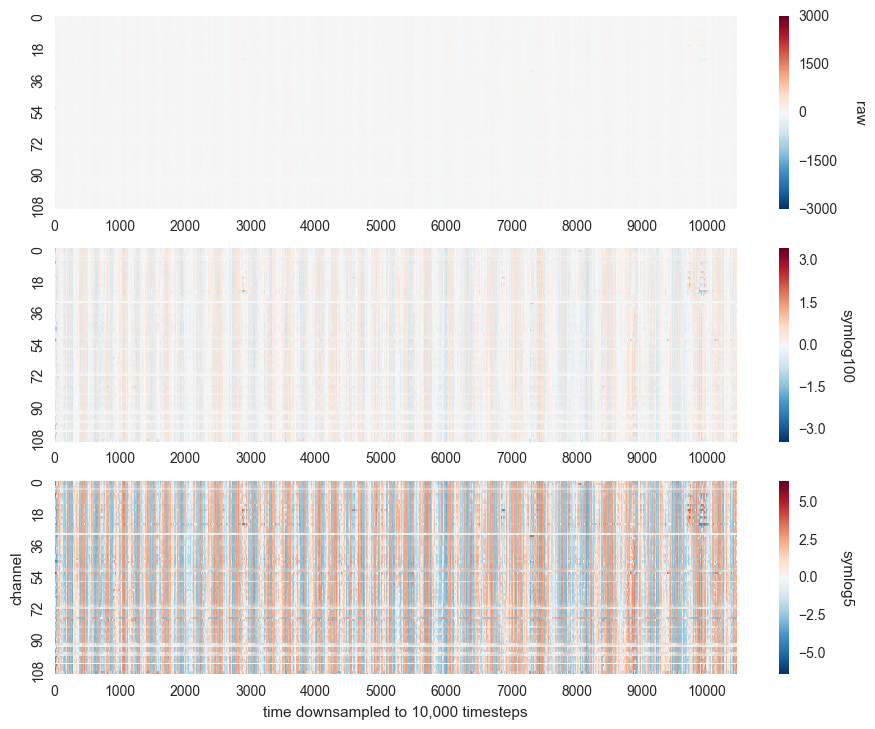

Noise Channel Heatmap


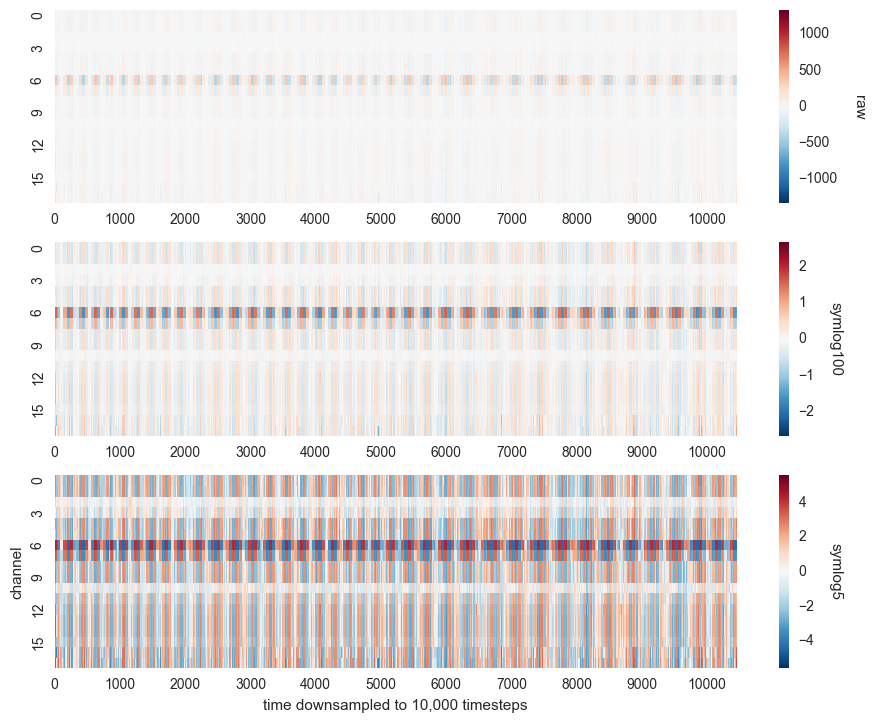

In [67]:
 print "EEG Data Heatmap"
viz.heatmap(D, {'eog_in': True}, p_global)
print "Noise Channel Heatmap"
viz.heatmap(D[p_global['eog_chans'], :], {'eog_in': False}, p_global)

##### Spectrograms

Spectrograms for three channels


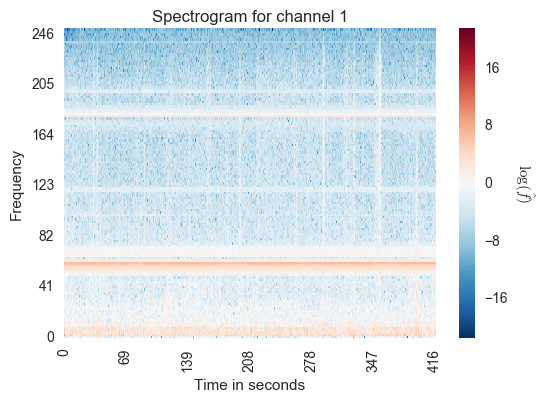

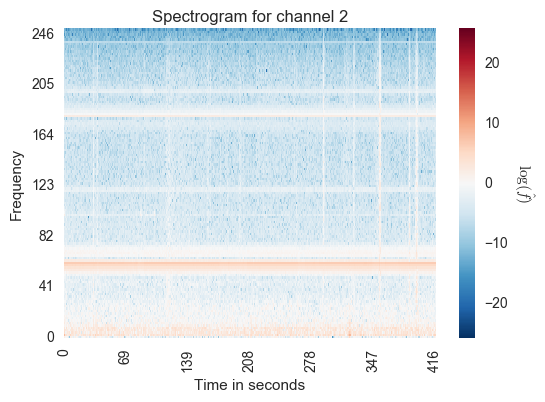

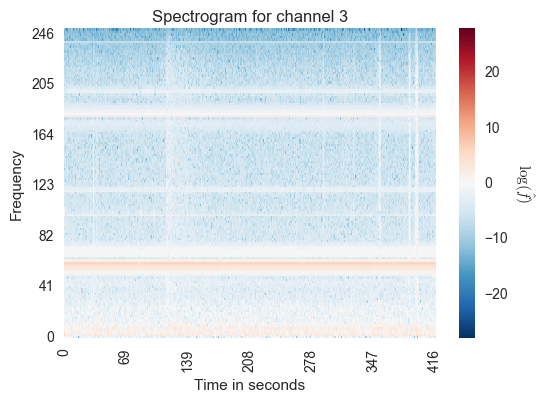

In [68]:
print "Spectrograms for three channels"
viz.spectrograms(D, {'eog_in': True}, p_global)

We now use a linear regression technique to remove the components of the observed scalpal EEG signal which is due to these noise channels.

### Setting
Suppose we have $D$ sensors discretely sampling activity of a system over time. These sensors will sample the activity of the system, along with noise. Suppose further that we have $d$ sensors, each placed near a region of noise. In our setting, the $D$ sensors are scalp electrodes and the $d$ sensors are facial, back, neck, and eye electrode channels.

We take the samples over time of these $D + d$ sensors and assume that our obervations are the sum of some unknown 'true' signal and a linear function of the activity at each of the $d$ noise regions. E.g.,
$$
Y = S + BN
$$
Where $N \in \mathbb{R}^{d \times T}$ is the noise matrix, $Y, S \in \mathbb{R}^{D \times T}$ are the observation and latent signal matrices respectively, and $B \in \mathbb{R}^{D \times d}$ is a signal mixing matrix (mixing the noise channels to get the component of each EEG channel due to the noise sources).

We would like to find an estimator $\hat{B}$ of the mixing matrix $B$.
E.g., given the loss function for $\hat{B}$ as
$$\mathcal{L}(\hat{B}) = \vert \vert S - (Y - \hat{B}N)\vert \vert $$
We would like the estimator to be the value which minimizes this loss, e.g.
$$
\hat{B} = \text{arg}\min_{B} \mathcal{L}(B)
$$
This way, we can take the matrix product $BN$ to recover the portion of the observation matrix $Y$ which is due to the $d$ noise sources (e.g. we can recover the signal by taking $S = Y - BN$).

We can solve for the best matrix $\hat{B}$ if we assume that the signals from the $d$ noise sensors and the true $D$ dimensional signal (the observations $Y$ minus any noise) are independent. This would give us that their covariance matrix is zero, e.g. that
$$
(S)N^T = 0 = (Y - BN)N^T = YN^T - BNN^T
$$
this would then imply that
$$
B = cov(Y, N) (cov(N, N))^{-1}
$$

This gives us an estimator for $\hat{B} = C_{YN}C_{NN}^{-1}$ where $C_{YN}$ is the covariance between the observations and the noise channels and $C_NN$ is the autocovariance of the noise channels.

This calculation requires space linear in the input size and time $O(TD)$.

#### Pseudocode
Let $D$ be the number of observation channels, let $d$ be the number of noise channels, let $T$ be the number of observed timesteps.

Input: $Y \in \mathbb{R^{D \times T}}, N \in \mathbb{d \times T}$ the observation and noise matrices.

Output: $S \in \mathbb{R^{D \times T}}$ the signal matrix (denoised matrix)


$EOG\_REGRESSION(Y, N):$
1. $C_{YN} = YN^T$
2. $C_{NN} = NN^T$
3. $B = C_{YN}(C_{NN})^{-1}$
4. $S = Y - BN$
5. **return** S

#### Real Code
The code for this function is located in our [`panda.denoise`](https://github.com/rmarren1/panda/blob/master/panda/methods/denoise.py) package in the `eog_regress` function.

### Simulations
For simulated data, we can measure effectiveness by taking the norm of the true signal matrix and the recovered signal matrix. For real data, we do not have any ground truth for the signal of the EEG system. We can only really make visual observations of the noise reduction of the system. A helpful addition to this data set would annotations of the EOG and EEG signals for when artifacts occur by a human expert, so that we could indeed have a quantitative measurement for performance in this task.

#### Generating Sample Data
We generate two types of sample data: data for which we expect the algorithm to perform well, and data for which we expect the algorithm to perform poorly.
1. (Good Case) The signal $S$ and the noise $N$ are independent in the above setting.
2. (Bad Case) The signal $S$ and the noise $N$ are dependent in the above setting.

In [69]:
import numpy as np
import matplotlib.pyplot as plt

def good_data(D, d, p_global):
    eeg_chans = p_global['eeg_chans']
    eog_chans = p_global['eog_chans']
    X = np.linspace(0, 10, 5000)
    params = [(np.random.uniform(5, 10) * np.pi, np.random.uniform() * 5) for i in range(D)]
    S = np.vstack([p[1] * np.sin(p[0] * X) for p in params])
    params = [(np.random.uniform(5, 10) * np.pi, np.random.uniform() * 5) for i in range(d)]
    N = np.vstack([p[1] * np.sin(p[0] * X) for p in params])
    B = np.random.uniform(-1, 1, size=[D, d])
    Y = np.zeros([D + d, X.size])
    Y[eeg_chans, :] = S + B.dot(N)
    Y[eog_chans, :] = N
    return Y, S, N

def bad_data(D, d, p_global):
    eeg_chans = p_global['eeg_chans']
    eog_chans = p_global['eog_chans']
    B = np.random.normal(size=[D, d])
    B_2 = np.random.normal(size=[D, d])
    X = np.linspace(0, 10, 5000)
    params = [(np.random.uniform(5, 10) * np.pi, np.random.uniform() * 2.5) for i in range(D)]
    S = np.vstack([p[1] * np.sin(p[0] * X) for p in params])
    params = [(np.random.uniform(5, 10) * np.pi, np.random.uniform() * 2.5) for i in range(d)]
    N = np.vstack([p[1] * np.sin(p[0] * X) for p in params])
    S = S + B_2.dot(N) # add dependence
    Y = np.zeros([D + d, X.size])
    Y[eeg_chans, :] = S + B.dot(N)
    Y[eog_chans, :] = N
    return Y, S, N

def sparklines(r, d, den, title):
    sns.set_style('whitegrid')
    C = d.shape[0]
    T = d.shape[1]
    fig = plt.figure(figsize=(12,1.5 * C))
    first = plt.subplot(C, 1, 1)
    plt.plot(d[0, :], 'b-', label = 'noisy')
    plt.plot(den[0, :], 'r-', label = 'denoised')
    plt.plot(r[0, :], 'g--', label = 'original')
    plt.title(title)
    plt.legend(bbox_to_anchor=(1.2, 1))
    plt.setp(first.get_xticklabels(), visible=False)
    plt.setp(first.get_yticklabels(), visible=False)
    plt.ylabel('1')
    for i in range(1, C):
        axes = plt.subplot(C, 1, i + 1, sharex = first)
        plt.plot(d[i, :], 'b-')
        plt.plot(den[i, :], 'r-')
        plt.plot(r[i, :], 'g--')
        plt.setp(axes.get_xticklabels(), visible=False)
        plt.setp(axes.get_yticklabels(), visible=False)
        plt.ylabel(str(i + 1))
    plt.tight_layout()
    plt.xlim([0,T])
    plt.subplots_adjust(top = 1, bottom = 0)
    return plt.gcf()

##### Qualatative Assessment (good)
Here we sample many signals and see whether or not visually our denoised signal is close to our latent signal than the noisy signal is. This is shown affirmatively below.

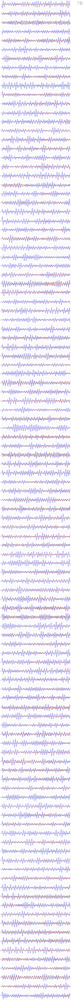

In [70]:
from panda.methods.denoise import eog_regress
Y, S, N = good_data(111, 18, p_global)
(S_hat, p_local) = eog_regress(Y, {}, p_global)
sparklines(S, Y[p_global['eeg_chans']], S_hat, '')
plt.show()

##### Quantitative Assessment (good)
Here, we repeat the above process many times, and take the $L_2$ norm of two signals as a measure of their distance. We want to see that the denoised signal is closer to the latent signal than the noisy signal is. This is answered affirmatively as shown below:

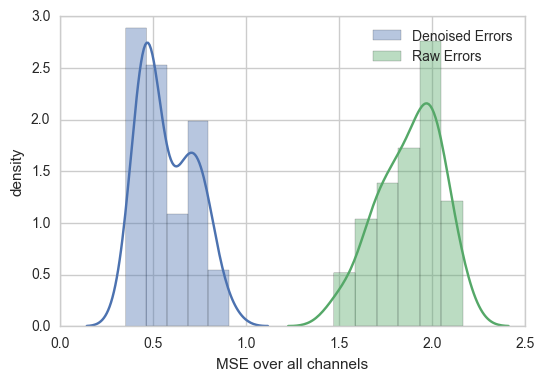

In [71]:
den_errs = []
raw_errs = []
for i in range(50):
    bigd = 111
    d = 18
    Y, S, N = good_data(bigd, d, p_global)
    (S_hat, p_local) = eog_regress(Y, {}, p_global)
    den_errs.append(np.linalg.norm(S_hat - S) / (bigd * d))
    raw_errs.append(np.linalg.norm(Y[p_global['eeg_chans'], :] - S) / (bigd * d))
sns.distplot(den_errs, label='Denoised Errors')
sns.distplot(raw_errs, label='Raw Errors')
plt.xlabel('MSE over all channels')
plt.ylabel('density')
plt.legend()
plt.show()

##### Qualatative Assessment (bad)
Here we sample many signals and see whether or not visually our denoised signal is close to our latent signal than the noisy signal is. We expect this to fail here since the signal is not indepdndent from the noise.

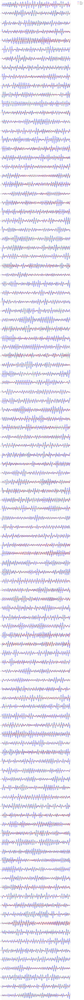

In [72]:
Y, S, N = bad_data(111, 18, p_global)
(S_hat, p_local) = eog_regress(Y, {}, p_global)
sparklines(S, Y[p_global['eeg_chans']], S_hat, '')
plt.show()

##### Quantitative Assessment (bad)
We do not expect the denoised signal to be much closer to the latent signal here than the noisy signal is, since the assumptions of the method we have chosen are not applicable for the bad data.

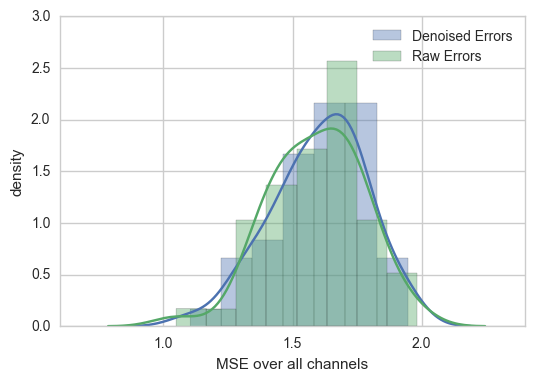

In [75]:
den_errs = []
raw_errs = []
for i in range(50):
    bigd = 111
    d = 18
    Y, S, N = bad_data(bigd, d, p_global)
    (S_hat, p_local) = eog_regress(Y, {}, p_global)
    den_errs.append(np.linalg.norm(S_hat - S) / (bigd * d))
    raw_errs.append(np.linalg.norm(Y[p_global['eeg_chans'], :] - S) / (bigd * d))
sns.distplot(den_errs, label='Denoised Errors')
sns.distplot(raw_errs, label='Raw Errors')
plt.xlabel('MSE over all channels')
plt.ylabel('density')
plt.legend()
plt.show()

### Application to Real Data
#### Running on real data

In [78]:
(D_eog, p_local) = eog_regress(D, {}, p_global)

#### Results
##### Heatmaps

Heatmaps


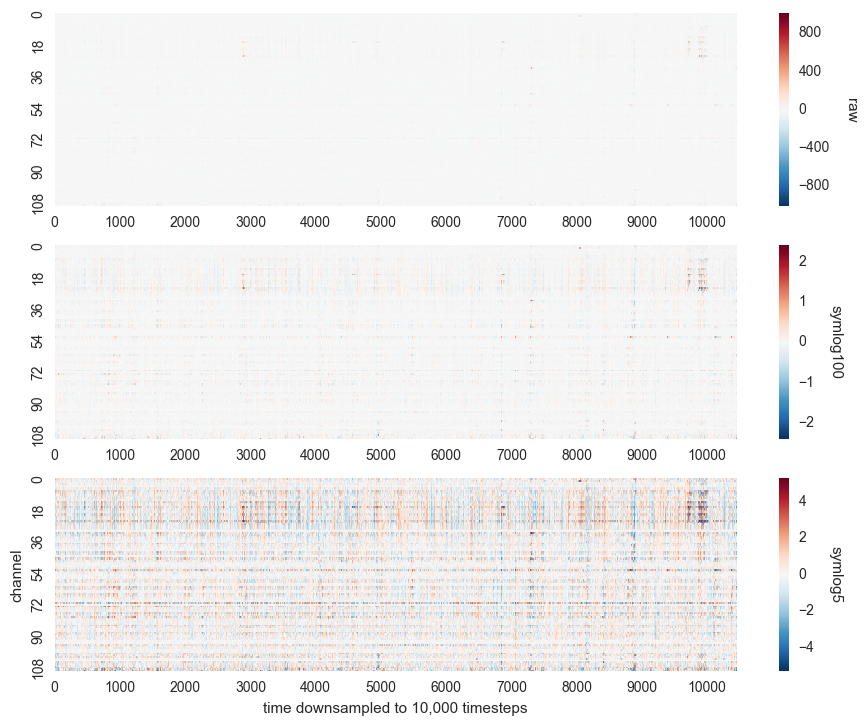

In [80]:
print 'Heatmaps'
viz.heatmap(D_eog, {'eog_in': False}, p_global)

##### Spectrograms

Spectrograms first 3 channels


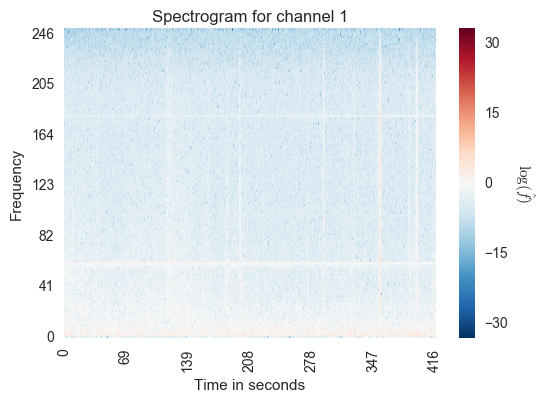

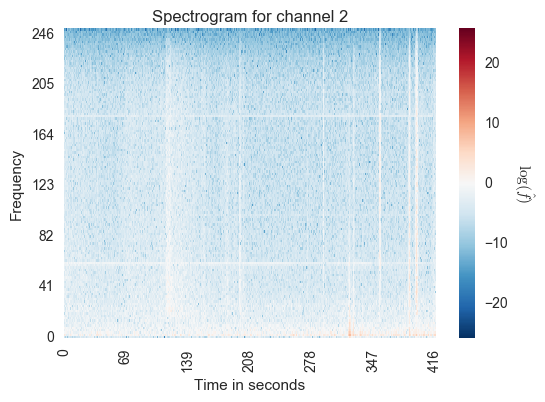

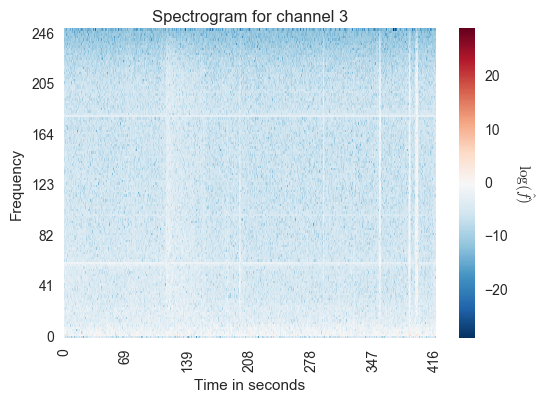

In [81]:
print 'Spectrograms first 3 channels'
viz.spectrograms(D_eog, {'eog_in': False}, p_global)

We notice that the dark bands in the spectrograms are either gone or heavily reduced, and we see that the heatmaps look much more reasonable (i.e. there are not dark horizontal bands oscillating between red and blue).

#### Results...
Here are the discriminibility results after running this function on an entire dataset (after the preceding functions in the pipeline)...
![image](../results/bids_raw/disc-heat-_eog_regress.png)
And here are the distributions of the intra and inter subject distances.
![image](../results/bids_raw/dists-eog_regress.png)